In [22]:
library(RSNNS)
library(NeuralNetTools)
#funtion to better show profile
profile <- function(x,y)
{
h=hist(x,plot=F)
boxplot(y ~ cut(x,h$breaks))
}

In [49]:
# create a sample x vs y whose radius is gaussian and theta uniform
n=1000 # size
sig=2  # spread
muestra1=10 #mean radius sample A 
muestra2=7  #mean radius sample B
par.def=dput(par(no.readonly=TRUE))

list(xlog = FALSE, ylog = FALSE, adj = 0.5, ann = TRUE, ask = FALSE, 
    bg = "white", bty = "o", cex = 1, cex.axis = 1, cex.lab = 1, 
    cex.main = 1.2, cex.sub = 1, col = "black", col.axis = "black", 
    col.lab = "black", col.main = "black", col.sub = "black", 
    crt = 0, err = 0L, family = "", fg = "black", fig = c(0, 
    1, 0, 1), fin = c(6.66666666666667, 6.66666666666667), font = 1L, 
    font.axis = 1L, font.lab = 1L, font.main = 2L, font.sub = 1L, 
    lab = c(5L, 5L, 7L), las = 0L, lend = "round", lheight = 1, 
    ljoin = "round", lmitre = 10, lty = "solid", lwd = 1, mai = c(1.02, 
    0.82, 0.82, 0.42), mar = c(5.1, 4.1, 4.1, 2.1), mex = 1, 
    mfcol = c(1L, 1L), mfg = c(1L, 1L, 1L, 1L), mfrow = c(1L, 
    1L), mgp = c(3, 1, 0), mkh = 0.001, new = FALSE, oma = c(0, 
    0, 0, 0), omd = c(0, 1, 0, 1), omi = c(0, 0, 0, 0), pch = 1L, 
    pin = c(5.42666666666667, 4.82666666666667), plt = c(0.123, 
    0.937, 0.153, 0.877), ps = 12L, pty = "m", smo = 1, srt = 0, 
    tc

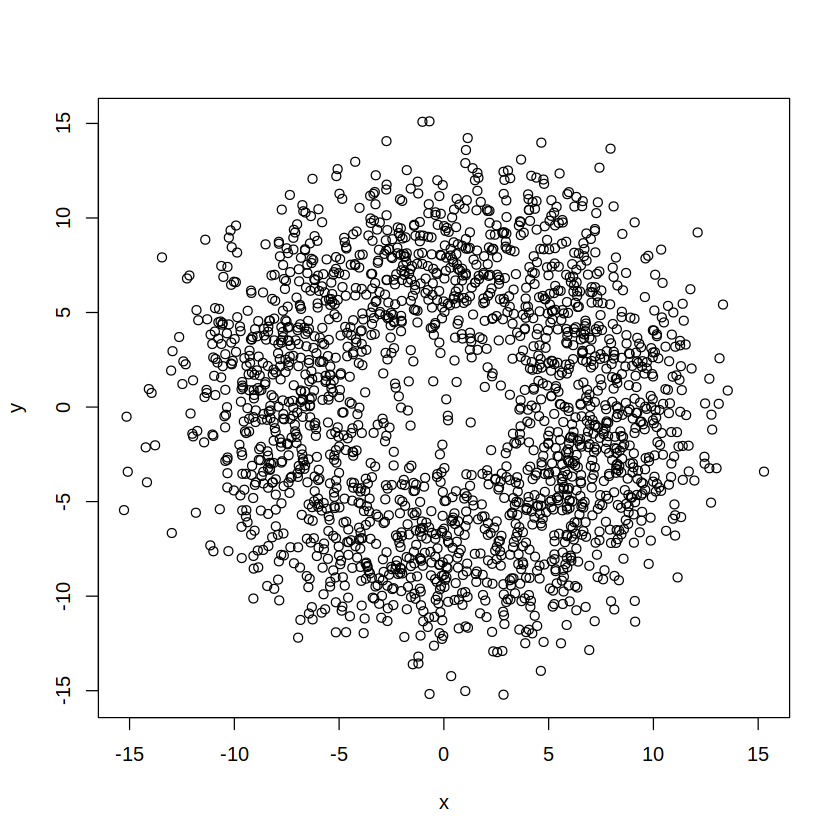

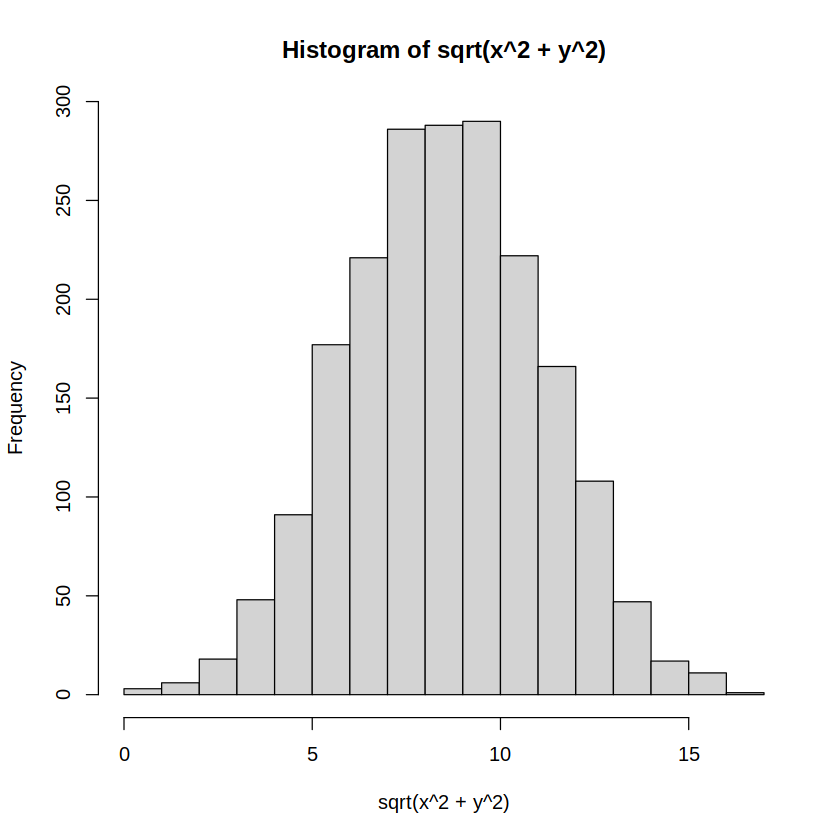

In [50]:
r=rnorm(n,muestra1,sig)
th=runif(n,0,2*pi)
r2=rnorm(n,muestra2,sig)
th2=runif(n,0,2*pi)
x=c(r*cos(th),r2*cos(th2))
y=c(r*sin(th),r2*sin(th2))
# add two random (non-informative) variables
z=runif(2*n)
z2=runif(2*n)
plot(x,y) # plot to check
 #wait enter to continue
hist(sqrt(x^2+y^2)) #radial view

List of 4
 $ inputsTrain : num [1:1700, 1:4] 10.1543 -1.9899 3.0504 0.0081 2.0585 ...
  ..- attr(*, "dimnames")=List of 2
  .. ..$ : chr [1:1700] "926" "1829" "77" "1189" ...
  .. ..$ : chr [1:4] "x" "y" "z" "z2"
 $ targetsTrain: num [1:1700] 1 0 1 0 0 0 0 1 0 1 ...
 $ inputsTest  : num [1:300, 1:4] -5.797 0.307 -3.7 -11.001 4.109 ...
  ..- attr(*, "dimnames")=List of 2
  .. ..$ : chr [1:300] "1234" "1797" "1993" "1418" ...
  .. ..$ : chr [1:4] "x" "y" "z" "z2"
 $ targetsTest : num [1:300] 0 0 0 0 1 1 0 1 1 0 ...
SNNS network definition file V1.4-3D
generated at Wed Jan 18 10:24:00 2023

network name : RSNNS_untitled
source files :
no. of units : 30
no. of connections : 150
no. of unit types : 0
no. of site types : 0


learning function : BackpropMomentum
update function   : Topological_Order


unit default section :

act      | bias     | st | subnet | layer | act func     | out func
---------|----------|----|--------|-------|--------------|-------------
 0.00000 |  0.00000 | i  |    

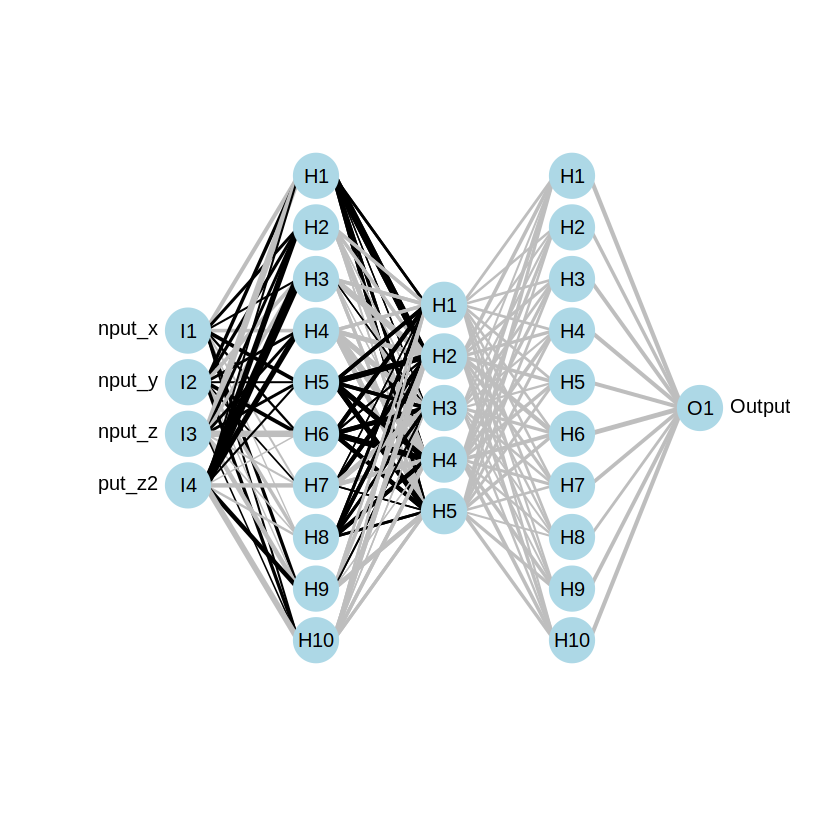

In [61]:
# create a labelled data frame, vars and target (1, 0)
trai=data.frame(x,y,z,z2,c(rep(1,n),rep(0,n)))
colnames(trai)=c("x","y","z","z2","tr")
# some operations to mix classes
nc=ncol(trai)
trai=trai[sample(1:nrow(trai),length(1:nrow(trai))),1:nc]
Values <- trai[,1:nc-1]
#Targets <- decodeClassLabels(trai[,nc]) # Internal RSNNS function to illustrate with iris
Targets <- trai[,nc] 
# split 15% of the sample for test
trai <- splitForTrainingAndTest(Values, Targets, ratio=0.15)
#normalize/preprocess
#trai <- normTrainingAndTestSet(trai,type="0_1") # norm 0_1 o center 
str(trai)
# size defines the topology size=n one hidden with n neurons, size=c(n,m,s), three layers with n,m,s
# outputActFunc, activation function
# learnFunc learning type with learnFuncParams defining the parameter(s) i.e. learning rate, momentum
# maxit number of iterations 
#http://www.ra.cs.uni-tuebingen.de/SNNS/UserManual/node52.html
model <- mlp(trai$inputsTrain,trai$targetsTrain,size=c(10,5,10),
             inputsTest = trai$inputsTest, targetsTest = trai$targetsTest,
             outputActFunc = "Act_Logistic",
#             learnFunc = "Std_Backpropagation",learnFuncParams = c(0.1),
             learnFunc = "BackpropMomentum",learnFuncParams = c(0.1,0.1), 
#             learnFunc = "SCG", learnFuncParams = c(0.1),
              maxit = 500)
summary(model) #summarize results
plotnet(model) #plot the network with weight importance drawn with the line thickness

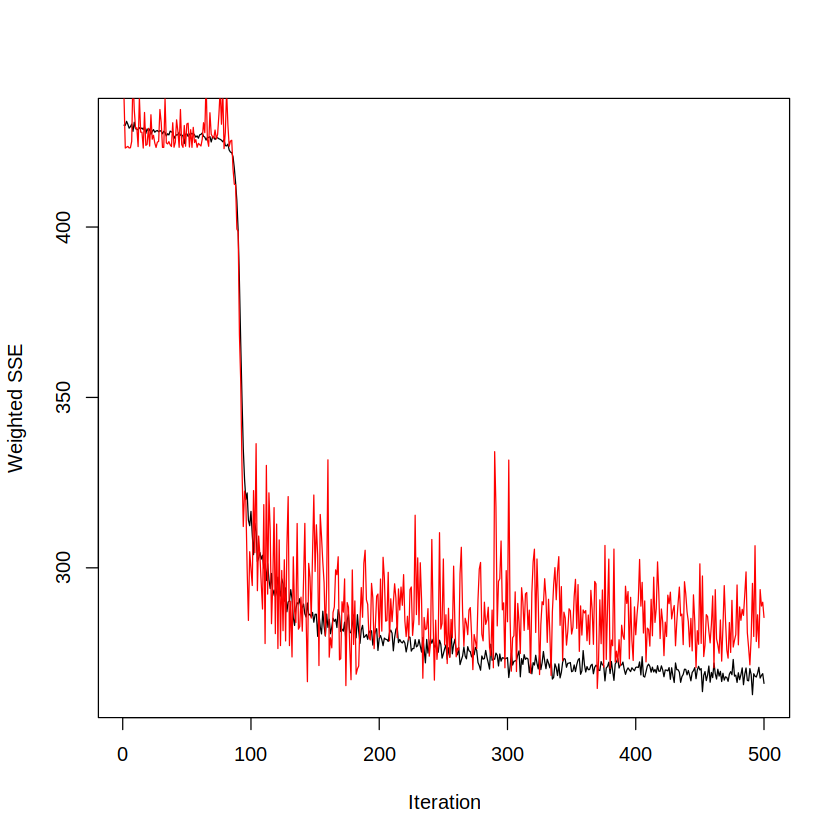

In [62]:
plotIterativeError(model)

[1] NA

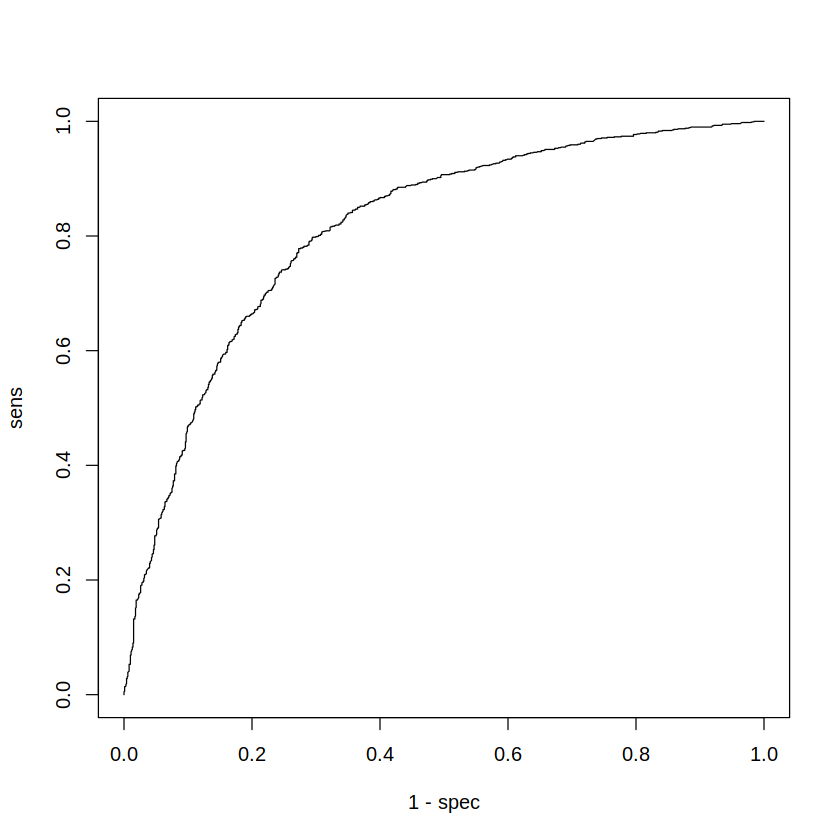

In [63]:
sum(model$fitted.values[Targets==0]>0.5)
plotROC(model$fitted.values,Targets)

$names
 [1] "nInputs"               "maxit"                 "initFunc"             
 [4] "initFuncParams"        "learnFunc"             "learnFuncParams"      
 [7] "updateFunc"            "updateFuncParams"      "shufflePatterns"      
[10] "computeIterativeError" "snnsObject"            "archParams"           
[13] "IterativeFitError"     "IterativeTestError"    "fitted.values"        
[16] "fittedTestValues"      "nOutputs"             

$class
[1] "mlp"   "rsnns"

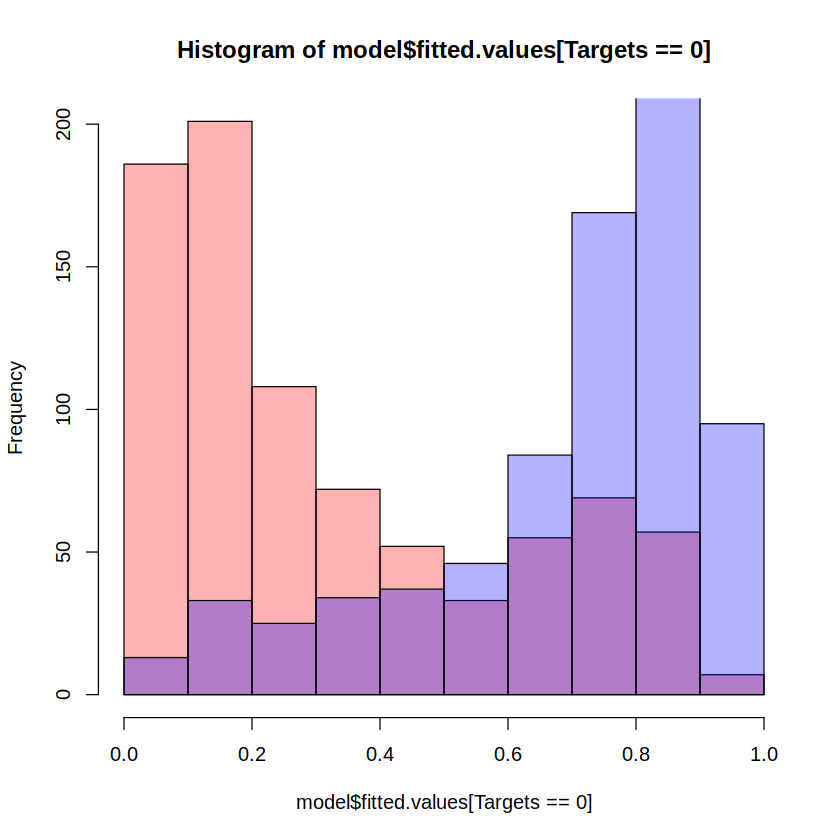

In [64]:
attributes(model)
hist(model$fitted.values[Targets==0],col=rgb(1,0,0,0.3))
hist(model$fitted.values[Targets==1],col=rgb(0,0,1,0.3),add=T)

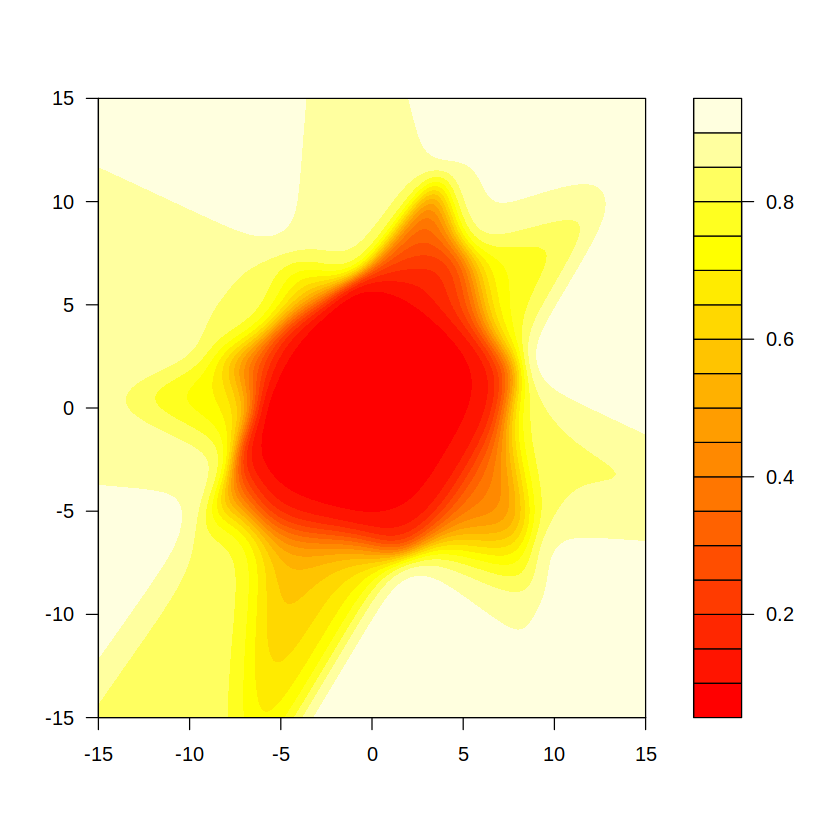

In [65]:
xn=seq(-15,15,by=0.2)
yn=seq(-15,15,by=0.2)
out=outer(xn,yn,function(x,y){predict(model,data.frame(x,y,0,0))})
filled.contour(xn,yn,out,color=heat.colors)

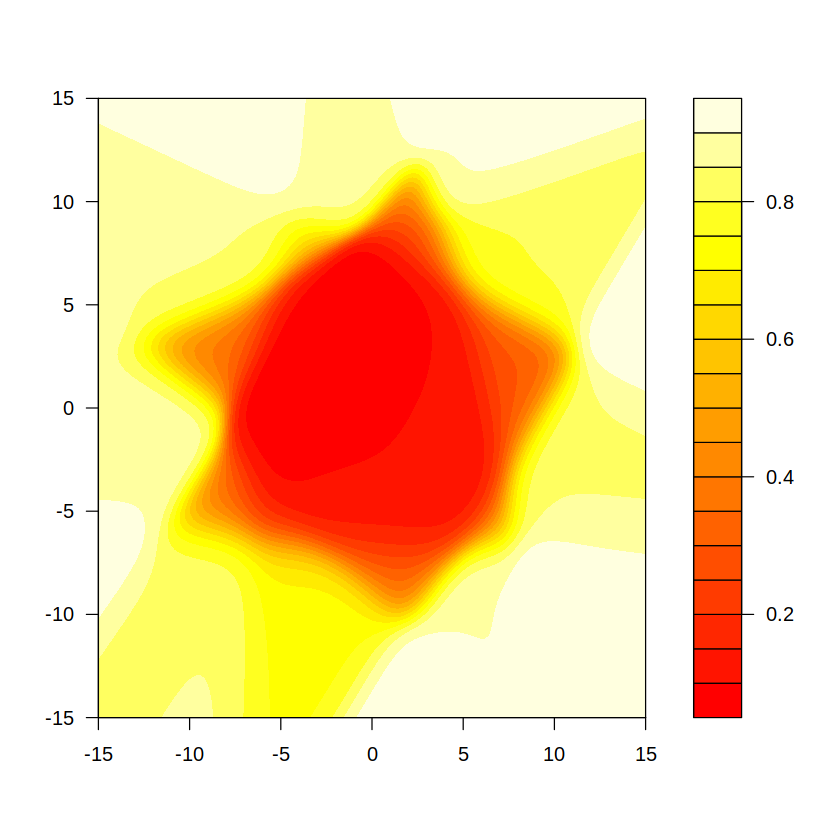

In [66]:
out=outer(xn,yn,function(x,y){predict(model,data.frame(x,y,1,1))})
filled.contour(xn,yn,out,color=heat.colors)

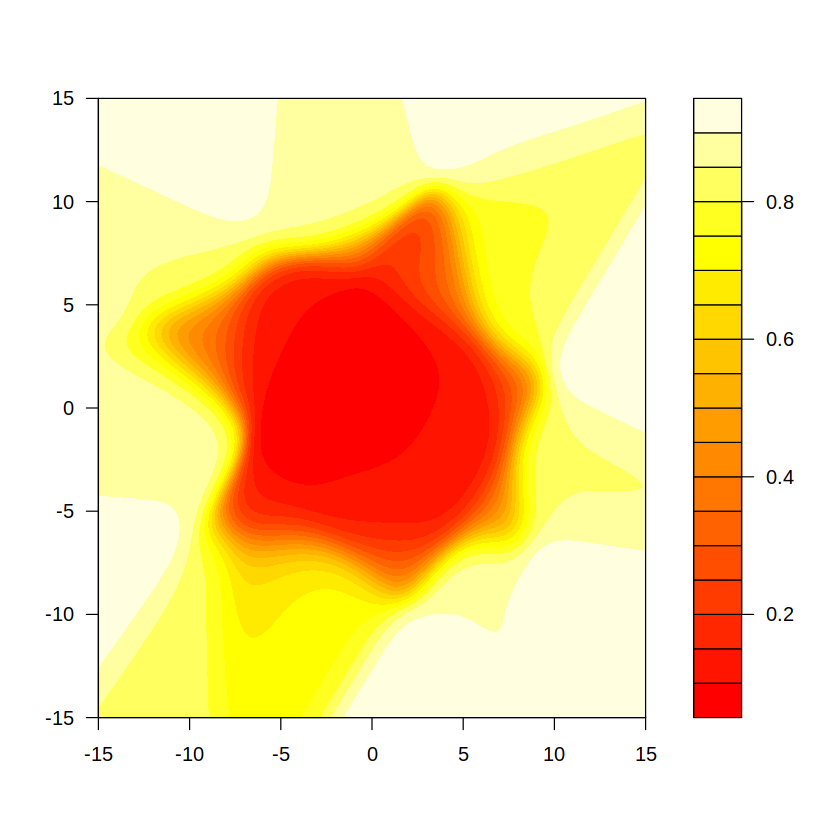

In [67]:
out=outer(xn,yn,function(x,y){predict(model,data.frame(x,y,0,1))})
filled.contour(xn,yn,out,color=heat.colors)

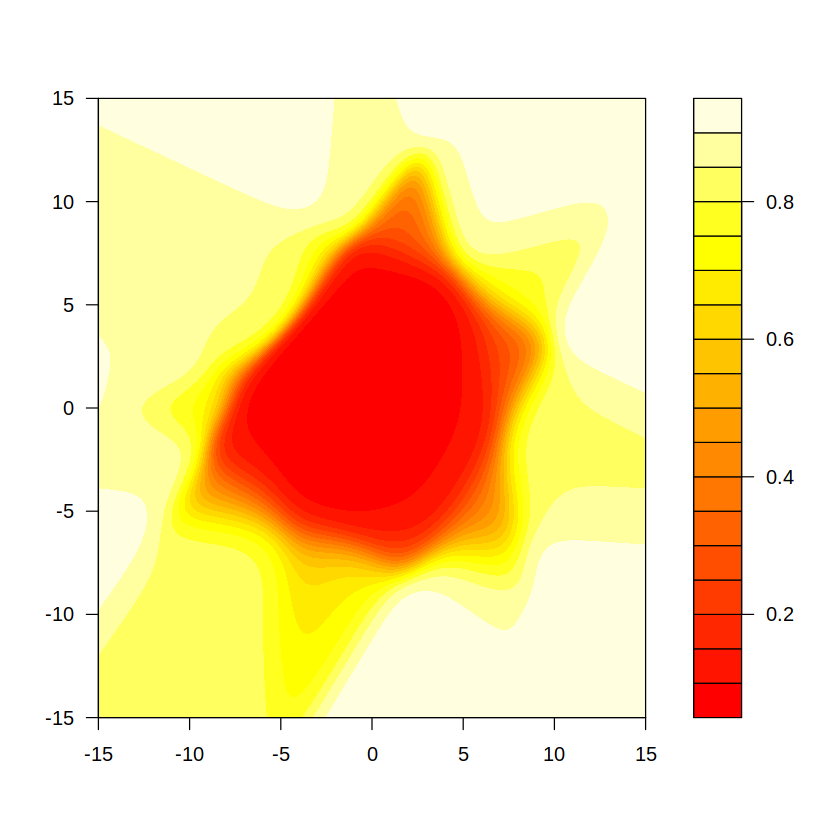

In [68]:
out=outer(xn,yn,function(x,y){predict(model,data.frame(x,y,1,0))})
filled.contour(xn,yn,out,color=heat.colors)

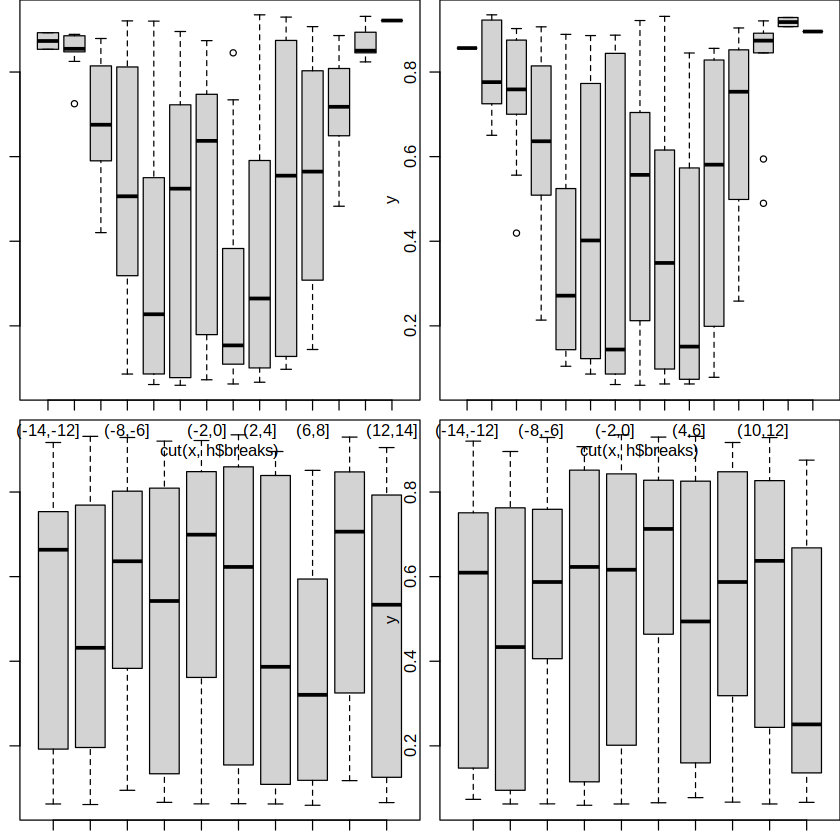

In [69]:
par(mfrow = c(2, 2),     # 2x2 layout
    oma = c(0, 0, 0, 0), # two rows of text at the outer left and bottom margin
    mar = c(1, 1, 0, 0), # space for one row of text at ticks and to separate plots
    mgp = c(2, 1, 0),    # axis label at 2 rows distance, tick labels at 1 row
    xpd = NA)            # allow content to protrude into outer margin (and beyond)
profile(trai$inputsTest[,1],predict(model,trai$inputsTest))
profile(trai$inputsTest[,2],predict(model,trai$inputsTest))
profile(trai$inputsTest[,3],predict(model,trai$inputsTest))
profile(trai$inputsTest[,4],predict(model,trai$inputsTest))

In [70]:
par(par.def)

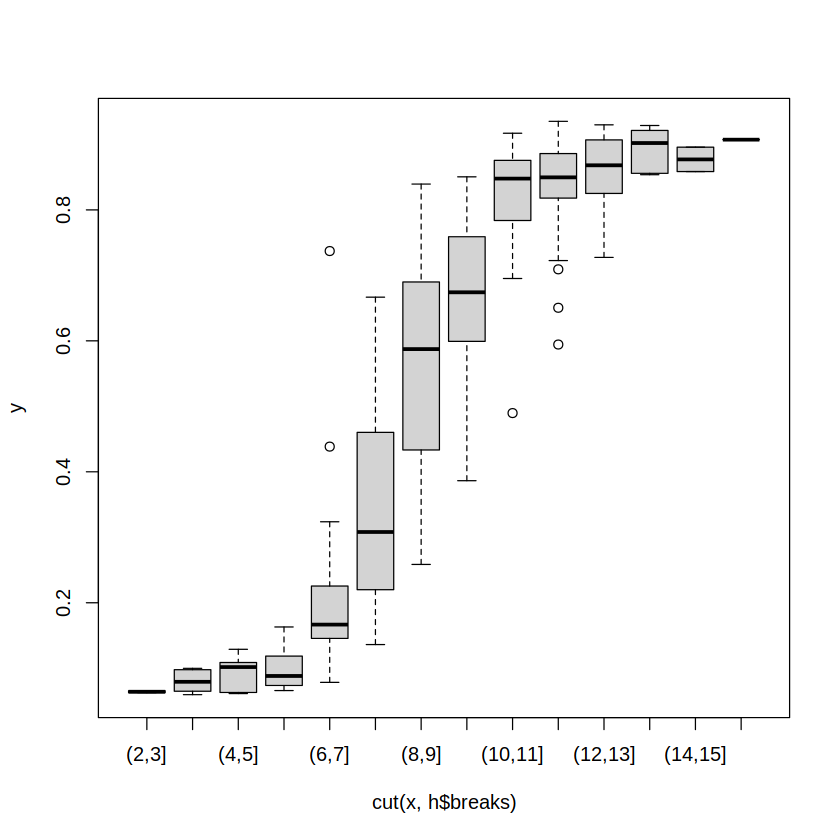

In [71]:
profile(sqrt(trai$inputsTest[,2]**2+trai$inputsTest[,1]**2),predict(model,trai$inputsTest))